# <img src="https://img.icons8.com/bubbles/100/000000/3d-glasses.png" style="height:50px;display:inline"> University of Haifa - Computer Vision


## Homework 1
---

### <a style='color:red'> Due Date: 11.06.2024 </a>

### Useful imports
---

In [ ]:
# imports for the tutorial - YOU MAY ADD MORE IF NEEDED
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow
from scipy.ndimage import maximum_filter
import itertools

### Arrays


### <img src="https://img.icons8.com/office/80/000000/edit-image.png" style="height:50px;display:inline"> **Exercise: Hough Triangles**
---
In this part, we are going to implement detectors for particular types of triangles: 1) **Equilateral** triangles - ones that have 3 equal sides (and 3 equal angles); 2) **Isosceles** triangles - Ones with two sides of equal length (and equal base angles); 3) **Right** triangles - ones that have a 90 degree angle;

We are going to do so based on the processing of the standard Hough Transform (HT) Map that is used for detecting lines (with the $\theta, d$ parameterization). See the following cell evaluation for a full illustrative example.

Submit outputs on **4 input images** of your choice: Choose one from each group (folder) of images provided.


**Recommendations**:
* You can tune the parameters (like edge detection thresholds, HT resolution) of your solution seperately per input image. However, the method should be generic and run on all the input images without any manual interventions (other than parameter changes).
* You can use the 'sliding-window' HT variant that we discussed in class. That is, you can run the HT on a sliding $r\times r$ window, with skips of size $s$ (both vertical and horizontal). You are allowed to choose the sizes $r$ and $s$ manually per image (by determining the maximal size of a triangle to detect).
* To improve the detected lines (maxima in HT) you should aim to improve the edge map and apply some kind of suprression on the HT-map (e.g. filter out lines that are too close in some senses, lines that have weak support, etc').

**Output format** (per input image):

1. Input image
2. Edge map
3. Hough transform (one per window with triangle detection, if using sliding window) - Should include marking of all detected lines by small square markers, with the color-coding of blue/green/red for equilateral/isosceles/right triangle sides.
4. Detected lines (one per window with triangle detection, if using sliding window) - Shown over the edge map.
5. Detected triangles - Shown by taking the edge map and coloring every edge point that belongs to a triangle by its color-coding specified above.

**Guidelines**:
* Run the next cell to see an example (that doesn't use a sliding window).
* Write your code in the cell that follows (You may add as many cells as you want).
* You may use existing code (from cv2 or any other library) for loading, displaying, overlaying, saving images as well as for edge-detection and other standard image filtering operations.
* You must provide **your own implementation** of the line Hough Transform. Make sure that your code is properly commented.
* The very last cell of your code should generate the outputs for each of the images.
* The very last cell of this notebook (after your code and output images) is where you should explain your solution according to the guidelines given there.

### **Your code**
---
Write your code (that must be commented and executed before submission) in the following cells.
You may use as many text or code cells that you need.

# **Find Edge Map**
This function finds Edge map of the image.


1.   **Input:** image, two canny thresholds

2.  **Output**: edge map of an image


In [ ]:
def create_edge_map(image, threshold1 = 50, threshold2 = 150):
    edges = cv2.Canny(image, threshold1, threshold2, apertureSize=3)
    return edges

# **Find Hough Transform**
This function find the hough transform of an image.


1.   **Input**: edges map, resolution of accumlator along the rho axis, resolution of accumlator along the theta axis.

2.   **Output**: accumaltor, all rhos and thetas that represent the lines.



In [ ]:

def hough_transform(edges, rho_res=1, theta_res=np.pi/180):

    height, width = edges.shape

    max_dist = int(np.hypot(height, width))

    rhos = np.arange(-max_dist, max_dist, rho_res)

    thetas = np.arange(0, np.pi, theta_res)

    accumulator = np.zeros((len(rhos), len(thetas)), dtype=int)

    y_idxs, x_idxs = np.nonzero(edges)

    for i in range(len(x_idxs)):

        x = x_idxs[i]
        y = y_idxs[i]

        for t_idx in range(len(thetas)):

            theta = thetas[t_idx]
            rho = int(x * np.cos(theta) + y * np.sin(theta))
            rho_idx = np.argwhere(rhos == rho)[0][0]
            accumulator[rho_idx, t_idx] += 1

    return accumulator, rhos, thetas

# **Detect Lines And Draw Peaks**


1.  **First function**: find peaks given a threshold.

2.   **Second function**: detect the lines given to this peaks.
1.   **Third function:** Draw peaks on Hough.
2.   **Fourth Function:** Draw lines on edge map.









In [ ]:
def detect_peaks(accumulator, threshold):
    peaks = np.argwhere(accumulator > threshold)
    return peaks

def detect_lines(peaks, rhos, thetas):

    lines = []

    for peak in peaks:

        rho = rhos[peak[0]]
        theta = thetas[peak[1]]
        lines.append((rho, theta))

    return lines


def draw_classified_peaks_on_accumulator(accumulator, classified_triangles, rhos, thetas, peaks):

    plt.figure(figsize=(10, 10))
    plt.imshow(accumulator, cmap='gray', aspect='auto', extent=[thetas[0], thetas[-1], rhos[-1], rhos[0]])
    plt.title('Hough Transform with Peaks')
    plt.xlabel('Theta (radians)')
    plt.ylabel('Rho (pixels)')
    plt.colorbar()

    color_map = {
        'Equilateral': 'blue',
        'Right': 'red',
        'Isosceles': 'green',
        'Right Isosceles': 'green',
        'Scalene': 'white'
    }

    for triangle, classification in classified_triangles:
        color = color_map.get(classification, 'blue')
        for line in triangle[1]:
            rho, theta = line[0]
            rho_idx = np.argmin(np.abs(rhos - rho))
            theta_idx = np.argmin(np.abs(thetas - theta))
            plt.plot(thetas[theta_idx], rhos[rho_idx], 's', markerfacecolor=color, markeredgecolor=color, markersize=5)

    plt.show()


def draw_lines_on_image(edges ,classified_triangles, is_edge = False):

    for triangle, classification in classified_triangles:

      for line in triangle[1]:

          rho, theta = line[0]

          a = np.cos(theta)
          b = np.sin(theta)
          x0 = a * rho
          y0 = b * rho
          scale = edges.shape[0] + edges.shape[1]

          x1 = int(x0 + scale * (-b))
          y1 = int(y0 + scale * (a))
          x2 = int(x0 - scale * (-b))
          y2 = int(y0 - scale * (a))
          color = (0, 0, 255) if classification == "Equilateral" else (0, 255, 0) if classification in ["Isosceles", "Right Isosceles"] else (255, 0, 0) if classification == "Right" else (255, 255, 255)


          cv2.line(edges, (x1, y1), (x2, y2), color , 2)

    plt.figure(figsize=(10, 10))
    plt.imshow(edges, cmap='gray')
    plt.title('Detected Lines')
    plt.show()


# **Non Maximum Suppression**

we use this to remove redundant lines

In [ ]:
def non_maximum_suppression(lines, distance_threshold=10, angle_threshold=np.pi/30):
    suppressed_lines = []
    used = np.zeros(len(lines), dtype=bool)

    for i, ((adjusted_rho, adjusted_theta), (rho, theta)) in enumerate(lines):
        if not used[i]:
            suppressed_lines.append([(adjusted_rho, adjusted_theta), (rho, theta)])

            for j, ((adjusted_rho2, adjusted_theta2), (rho2, theta2)) in enumerate(lines):
                if i != j and not used[j]:
                    if np.abs(adjusted_rho - adjusted_rho2) < distance_threshold and np.abs(adjusted_theta - adjusted_theta2) < angle_threshold:
                        used[j] = True

    return suppressed_lines

# **Sliding Window**

for each window we:


1.   we computed edge map of window

2.   we computed Hough transform given edge map
1.   used Maximum filter to filter out redundant peaks in accumlator
2.   Detected peaks and lines
1.   used non max suppression to remove redundant lines
2.   for each filtered line we added it as detected lines and adjusted rho and theta for the original image.







In [ ]:
def sliding_window(image, window_height, window_width, step_size_right, step_size_down, threshold=30):

    height, width = image.shape
    lines_detected = []
    all_peaks = []
    accumulators = []

    for y in range(0, height - window_height + 1, step_size_down):
        for x in range(0, width - window_width + 1, step_size_right):
            curr_image = image[y:y+window_height, x:x+window_width]
            edge_map = create_edge_map(curr_image)

            accumulator, rhos, thetas = hough_transform(edge_map)
            acc_copy = accumulator.copy()
            max_point = maximum_filter(accumulator, size=(100, 100))
            accumulator[accumulator < max_point] = 0

            peaks = detect_peaks(accumulator, threshold)
            lines = detect_lines(peaks, rhos, thetas)
            accumulators.append([(acc_copy, rhos, thetas), lines, ((y, x), (y + window_height - 1, x + window_width - 1))])

            for peak in peaks:
                adjusted_rho = rhos[peak[0]] + x * np.cos(thetas[peak[1]]) + y * np.sin(thetas[peak[1]])
                adjusted_peak = (np.argmin(np.abs(rhos - adjusted_rho)), peak[1])
                all_peaks.append(adjusted_peak)

            for line in lines:
                rho, theta = line
                adjusted_rho = rho + x * np.cos(theta) + y * np.sin(theta)
                lines_detected.append([(adjusted_rho, theta), (rho, theta)])


            lines_detected = non_maximum_suppression(lines_detected)

    return lines_detected, all_peaks, accumulators


# **Find Triangles**

The main function here is find triangles that finds all triangles.
To detect triangles we implemented a few helper function:


1.   **find_line_intersection**: it find the intersection point of two lines

2.   **distance**: find Euclidean Distance between two points
1.   **create_mask**: it creats a mask of size of the image which hold a trinagle that represent the input points
2.   **is_triangle**: it do a bitwise and with the mask and the edge image, if the result contain number of nonzero pixels which are greater than a threshold means the mask represent a triangle in the real image.
1.   find_triangles: given edge image, detected lines, match trinagle threshold, length of side
    1.   Go over every combination of 3 lines
    2.   Find intersection point of current combination
    1.   this 3 point represent a trinagle, we compute their distance using Euclidean Distance. if one of the sides are less than threshold, then this is not a trinagle. else it is a candidates to be.
    2.   then we check if it is a triangle based on is_triangle function.





threshold








In [ ]:

def find_line_intersection(line1, line2):
    rho1, theta1 = line1
    rho2, theta2 = line2

    cos_theta1, sin_theta1 = np.cos(theta1), np.sin(theta1)
    cos_theta2, sin_theta2 = np.cos(theta2), np.sin(theta2)

    determinant = cos_theta1 * sin_theta2 - cos_theta2 * sin_theta1

    if np.abs(determinant) < 1e-10:
        return None  # parallel lines

    x = (sin_theta2 * rho1 - sin_theta1 * rho2) / determinant
    y = (-cos_theta2 * rho1 + cos_theta1 * rho2) / determinant

    return (int(round(x)), int(round(y)))


def distance(p1, p2):
    return np.sqrt((p1[0] - p2[0])**2 + (p1[1] - p2[1])**2)



def create_mask(image_shape, points):

    mask = np.zeros(image_shape, dtype=np.uint8)

    cv2.line(mask, points[0], points[1], 255, 1)
    cv2.line(mask, points[1], points[2], 255, 1)
    cv2.line(mask, points[2], points[0], 255, 1)
    return mask




def is_triangle(mask, edges, threshold=0.9):
    and_result = cv2.bitwise_and(mask, edges)

    if np.count_nonzero(mask) != 0:

      match_percentage = np.count_nonzero(and_result) / np.count_nonzero(mask)
      return match_percentage > threshold

    else:

      return False


def find_triangles(edges, lines, length_threshold=56, match_threshold=0.9):
    triangles = []


    for line1, line2, line3 in itertools.combinations(lines, 3):
        try:
            p1 = find_line_intersection(line1[0], line2[0])
            p2 = find_line_intersection(line2[0], line3[0])
            p3 = find_line_intersection(line3[0], line1[0])

            if p1 is None or p2 is None or p3 is None:
              continue

            # compute side of triangle
            d1 = distance(p1, p2)
            d2 = distance(p2, p3)
            d3 = distance(p3, p1)

            # check if all sides are greater than the length threshold
            if d1 > length_threshold and d2 > length_threshold and d3 > length_threshold:

                mask = create_mask(edges.shape, [p1, p2, p3])

                if is_triangle(mask, edges, match_threshold):

                    triangles.append([(p1, p2, p3), (line1, line2, line3)])

        except np.linalg.LinAlgError:
            # skip lines, they are parallel
            continue

    return triangles

# **Filter out redundant Triangles**

to filter out reduntent triangles we used:


1.   **are_close**: which retutn true if two triangles are to close based on threshold.

2.   **filter_invalid**: to validate triangles, there are cases when you can detect triangles which are not in the image.
1.   **triangles_are_too_close**: go over every combination of point to check if he two triangles are close.
2.   **remove_close_triangles**: filter out close triangles based on a threshold and function in pointer 3.





In [ ]:
def are_close(p11, p12, p13, p21, p22, p23, threshold):
  return distance(p11, p21) < threshold and distance(p12, p22) < threshold and distance(p13, p23) < threshold

def filter_invalid(triangles, image, threshold = -5):

  filtered_triangles = []

  for triangle in triangles:

    p11, p12, p13 = triangle[0]

    if (threshold > p11[0]  or threshold > p11[1]  or threshold > p12[0]  or threshold > p12[1] or threshold > p13[0]  or threshold > p13[1]):
        continue

    if p11[0] > image.shape[1] -threshold or p11[1] > image.shape[0] -threshold or p12[0] > image.shape[1] -threshold or p12[1] > image.shape[0] -threshold or p13[0] > image.shape[1] -threshold or p13[1] > image.shape[0] -threshold:
        continue

    filtered_triangles.append(triangle)

  return filtered_triangles



def triangles_are_too_close(triangle1, triangle2, threshold):

    p11, p12, p13 = triangle1
    p21, p22, p23 = triangle2

    if are_close(p11, p12, p13, p21, p22, p23, threshold) or are_close(p12, p11, p13, p21, p22, p23, threshold) or are_close(p11, p13, p12, p21, p22, p23, threshold) or are_close(p12, p13, p11, p21, p22, p23, threshold) or  are_close(p13, p11, p12, p21, p22, p23, threshold) or are_close(p13, p12, p11, p21, p22, p23, threshold):
        return True
    return False




def remove_close_triangles(triangles, threshold):
    unique_triangles = []

    for i, triangle in enumerate(triangles):

        keep = True

        for j in range(i):

            if triangles_are_too_close(triangle[0], triangles[j][0], threshold):
                keep = False
                break

        if keep:
            unique_triangles.append(triangle)

    return unique_triangles

# **Classify Triangles**

We classify the triangles based on the length of sides, to classify as:

1.  **Equilateral** : we checked of all the sides are equal
2.   **Isosceles**: we checked if two of it's sides are equal
3. **Right Isosceles**: we checked it is Isosceles and if it is right based on pythagoras


1.   List item
2.   List item






In [ ]:
def calculate_side_lengths(triangle):
    p1, p2, p3 = triangle[0]
    d1 = distance(p1, p2)
    d2 = distance(p2, p3)
    d3 = distance(p3, p1)
    return d1, d2, d3



def classify_triangle(triangle, threshold = 0.85, ri_thrsh = 0.04, i_thresh = 0.08, r_thresh = 0.04):

    p1, p2, p3 = triangle[0]

    d1, d2, d3 = calculate_side_lengths(triangle)

    sides = sorted([d1, d2, d3])


    # Equilateral
    flag_equilateral = d1/d2 > threshold and d2/d3 > threshold and d1/d3 > threshold and d2/d1 > threshold and d3/d2 > threshold and d3/d1 > threshold

    if (np.isclose(sides[0], sides[1] ) and np.isclose(sides[1], sides[2])) or flag_equilateral:
        return "Equilateral"

    # Isosceles
    flag_isosceles = (sides[0]/sides[1] > threshold) or  (sides[0]/sides[2] > threshold) or (sides[1]/sides[2] > threshold)

    if np.isclose(sides[0], sides[1], rtol=i_thresh) or np.isclose(sides[1], sides[2], rtol=i_thresh) or np.isclose(sides[0], sides[2], rtol=i_thresh):
        # Right isosceles
        flag_Right_Isosceles = sides[2]**2, sides[0]**2 + sides[1]**2 > threshold
        if np.isclose(sides[2]**2, sides[0]**2 + sides[1]**2, rtol=ri_thrsh) or flag_Right_Isosceles:

            return "Right Isosceles"
        return "Isosceles"

    # Check for right triangle
    if np.isclose(sides[2]**2, sides[0]**2 + sides[1]**2, rtol=r_thresh):
        return "Right"

    return "Scalene"

In [ ]:
def filter_accumulator_lines(classified_triangles, accumulators):
    # Extract the (rho, theta) values from classified triangles
    classified_lines = set()
    for triangle , clasi in classified_triangles:
        for line in triangle[1]:  # (line1, line2, line3)
            classified_lines.add((line[1][0], line[1][1]))  # Add (rho, theta)

    # Filter out lines that are not in any classified triangle
    filtered_accumulators = []

    for acc, lines, window in accumulators:
        filtered_lines = [line for line in lines if (line[0], line[1]) in classified_lines]
        if filtered_lines:
            filtered_accumulators.append((acc, filtered_lines, window))

    return filtered_accumulators
def plot_filtered_accumulators_and_edges(filtered_accumulators, classified_triangles, original_image):

    color_map = {
        'Equilateral': 'blue',
        'Right': 'red',
        'Isosceles': 'green',
        'Right Isosceles': 'green'
    }

    # Extract the (rho, theta) values from classified triangles
    classified_lines = {}
    for triangle, classification in classified_triangles:
        for line in triangle[1]:  # (line1, line2, line3)
            classified_lines[(line[1][0], line[1][1])] = classification  # Map (rho, theta) to classification



    for acc, lines, window in filtered_accumulators:
        accumulator, rhos, thetas = acc

        # Plot the accumulator with peak points
        plt.figure(figsize=(10, 10))
        accumulator = (accumulator/ np.max(accumulator)) * 255
        accumulator = np.uint8(accumulator)
        accumulator[accumulator != 0] += 70
        plt.imshow(accumulator, cmap='gray', aspect='auto', extent=[thetas[0], thetas[-1], rhos[-1], rhos[0]])
        plt.title('Hough Transform with Peaks')
        plt.xlabel('Theta (radians)')
        plt.ylabel('Rho (pixels)')
        plt.colorbar()

        for line in lines:
            rho, theta = line
            rho_idx = np.argmin(np.abs(rhos - rho))
            theta_idx = np.argmin(np.abs(thetas - theta))
            color = color_map.get(classified_lines[(rho, theta)], 'white')
            plt.plot(thetas[theta_idx], rhos[rho_idx], 's', markerfacecolor=color, markeredgecolor=color, markersize=5)

        plt.show()

        # Plot the edge image with filtered lines
        (y1, x1), (y2, x2) = window
        window_image = original_image[y1:y2, x1:x2]
        edge_map = create_edge_map(window_image)
        edge_map_color = cv2.cvtColor(edge_map, cv2.COLOR_GRAY2BGR)
        already_drawn = set()
        for line in lines:

          if line in classified_lines and line not in already_drawn:
            already_drawn.add(line)
            rho, theta = line
            a = np.cos(theta)
            b = np.sin(theta)
            x0 = a * rho
            y0 = b * rho
            scale = window_image.shape[0] + window_image.shape[1]

            x1_line = int(x0 + scale * (-b))
            y1_line = int(y0 + scale * (a))
            x2_line = int(x0 - scale * (-b))
            y2_line = int(y0 - scale * (a))

            color = (0, 0, 255) if classified_lines[(rho, theta)] == "Equilateral" else \
                    (0, 255, 0) if classified_lines[(rho, theta)] in ["Isosceles", "Right Isosceles"] else \
                    (255, 0, 0) if classified_lines[(rho, theta)] == "Right" else (255, 255, 255) if classified_lines[(rho, theta)] == "Scalene" else 0

            if color != 0:
              cv2.line(edge_map_color, (x1_line, y1_line), (x2_line, y2_line), color, 2)

        plt.figure(figsize=(10, 10))
        plt.imshow(edge_map_color, cmap='gray')
        plt.title('Edge Image with Filtered Lines')
        plt.show()

# **From Sketch Group**

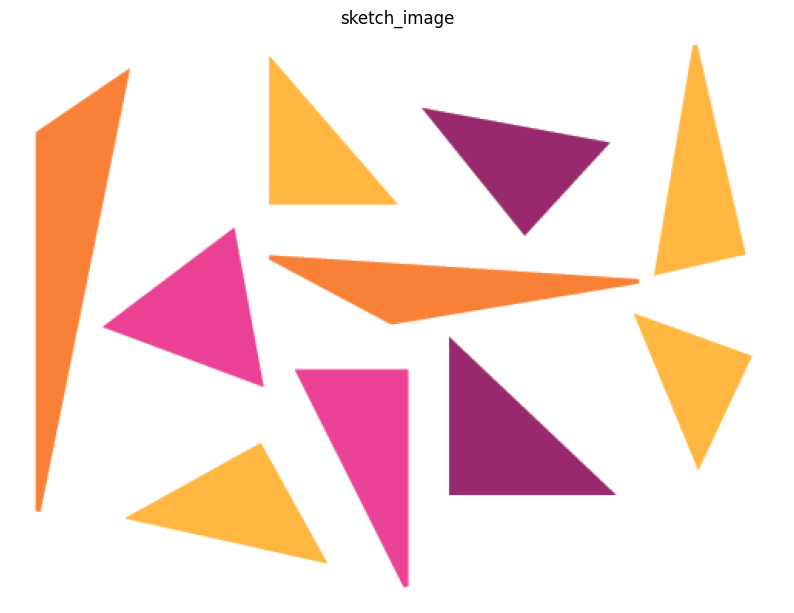

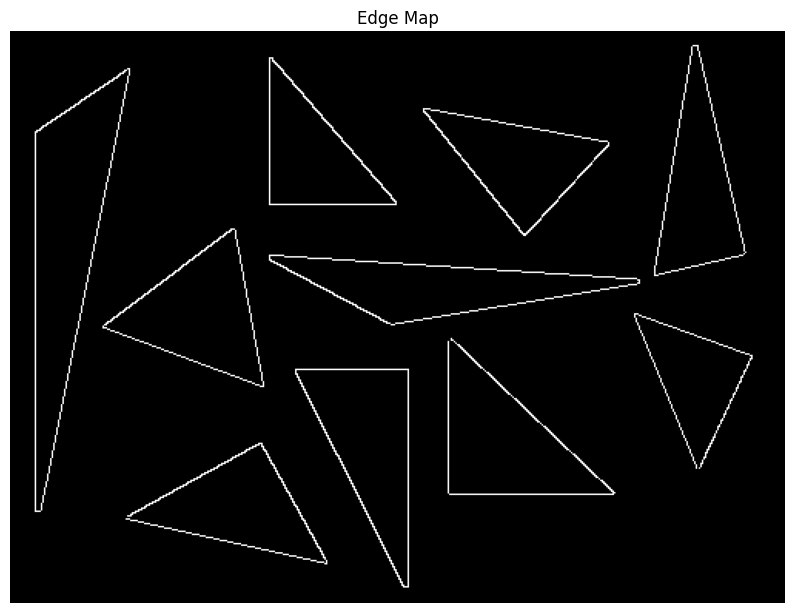

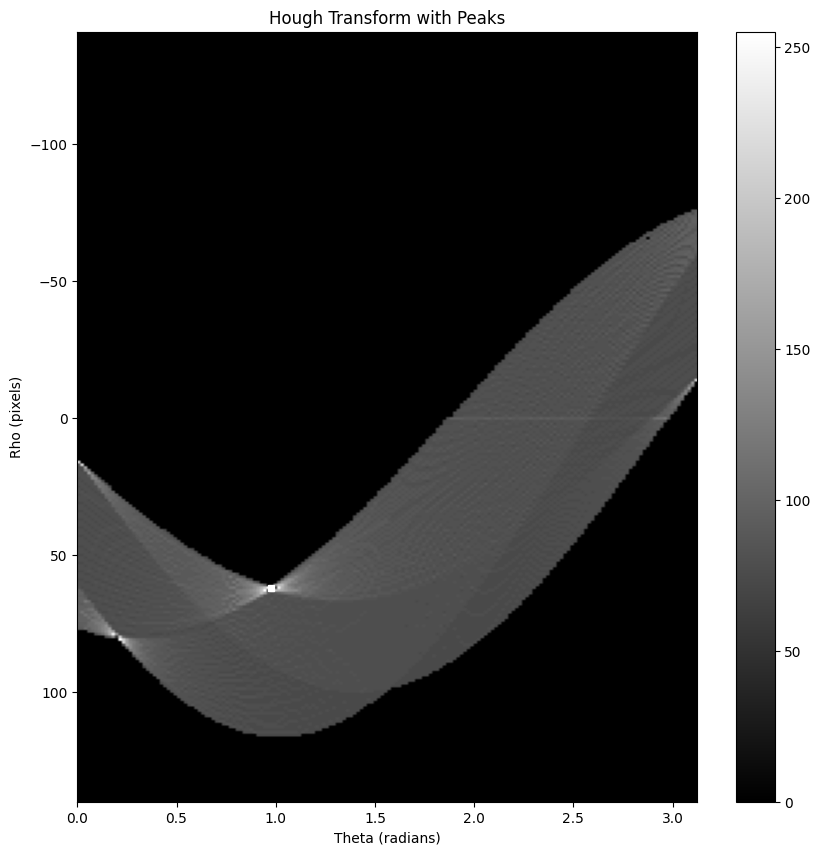

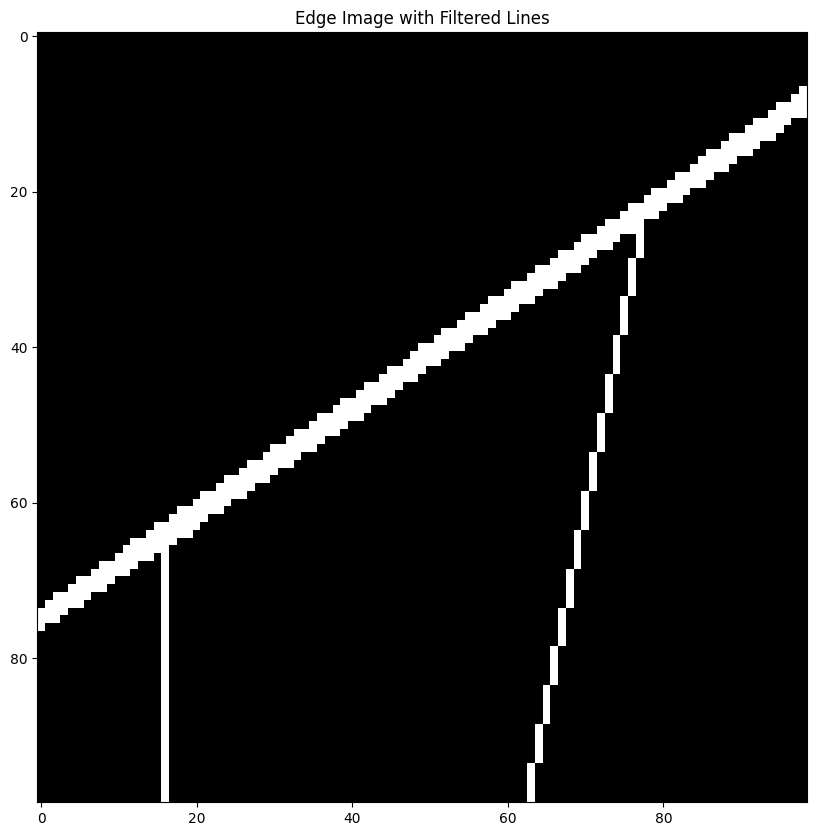

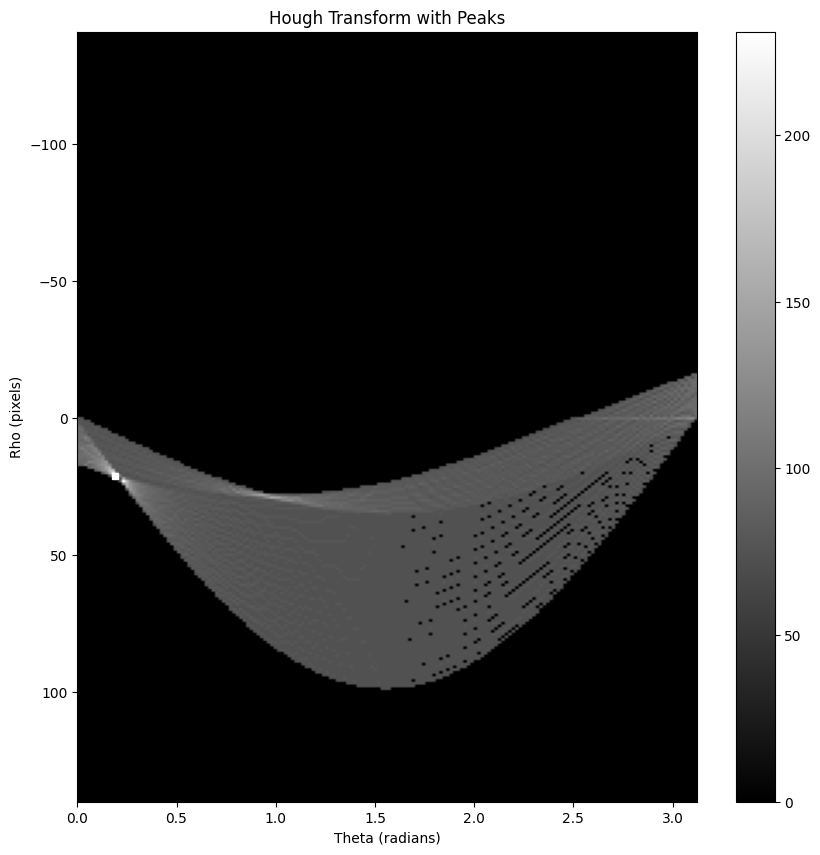

...

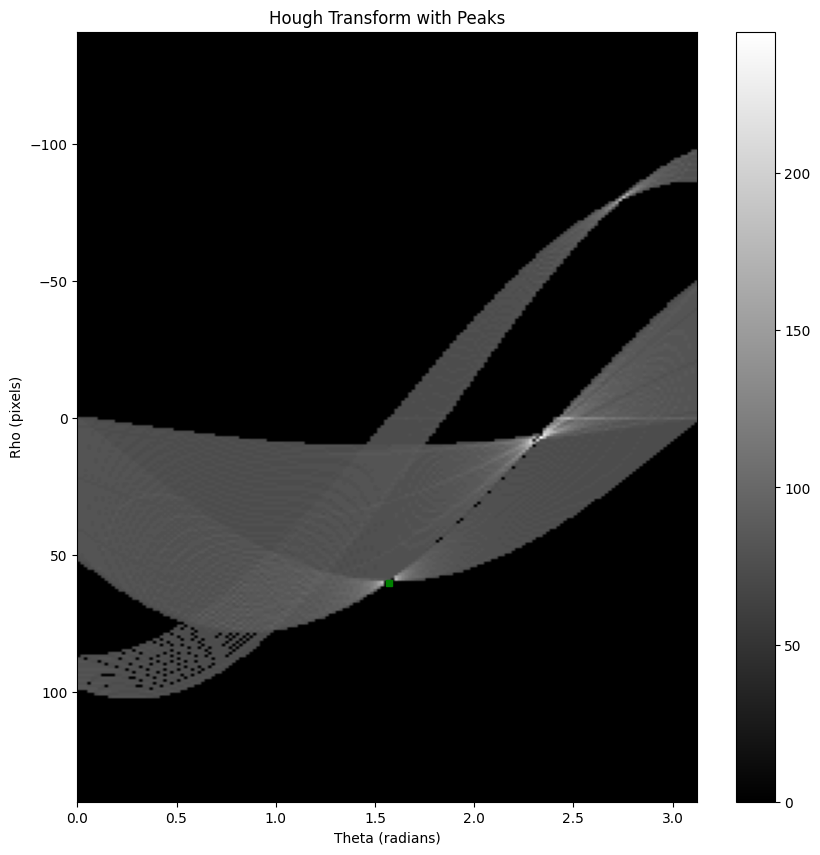

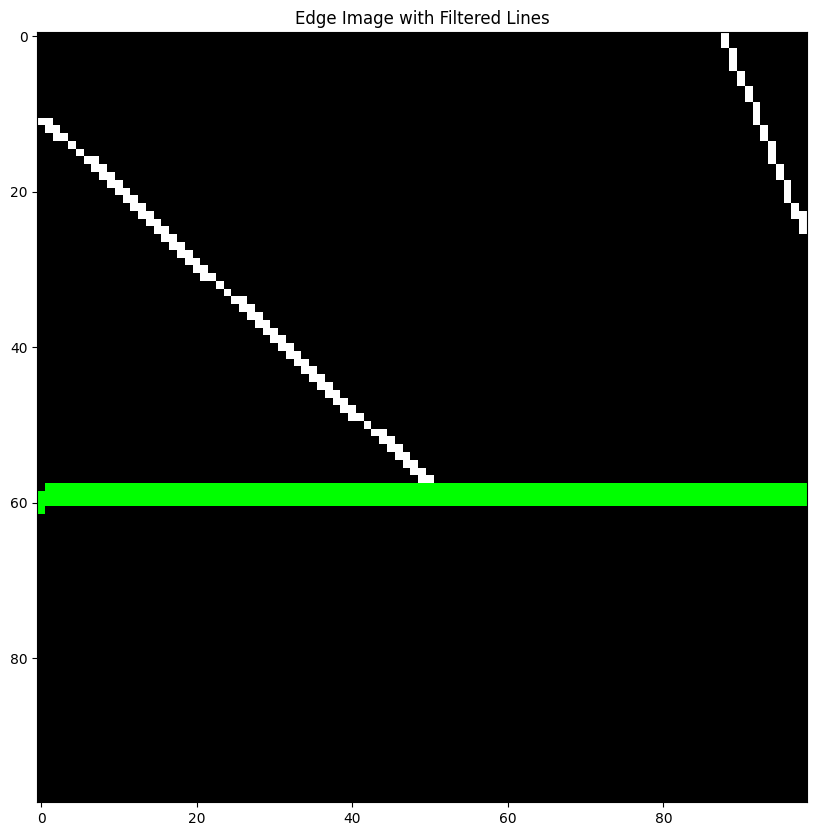

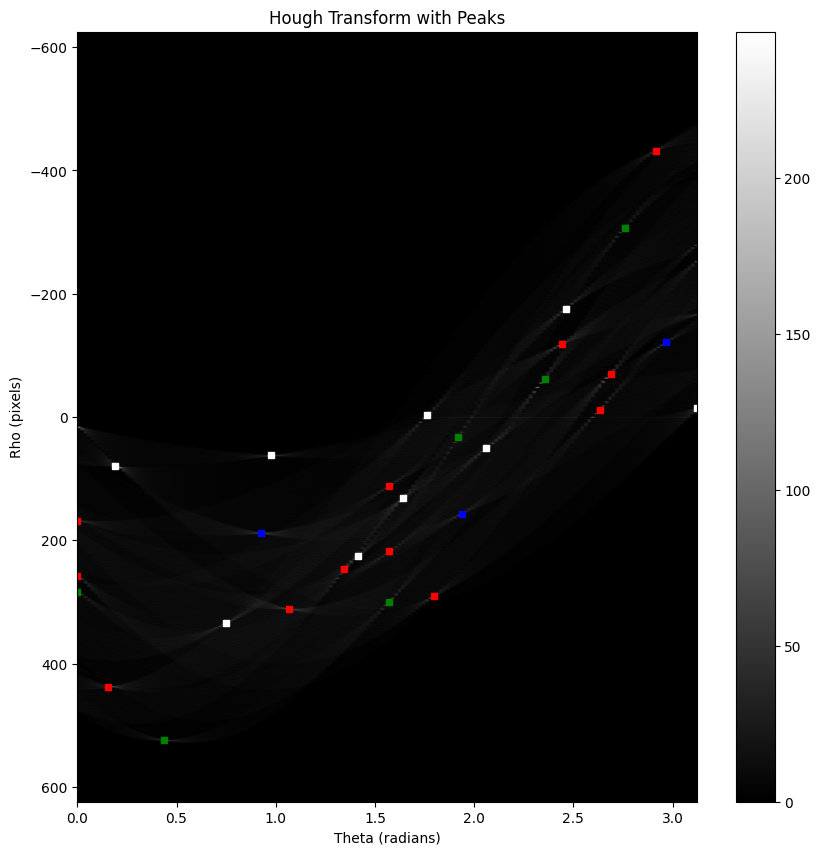

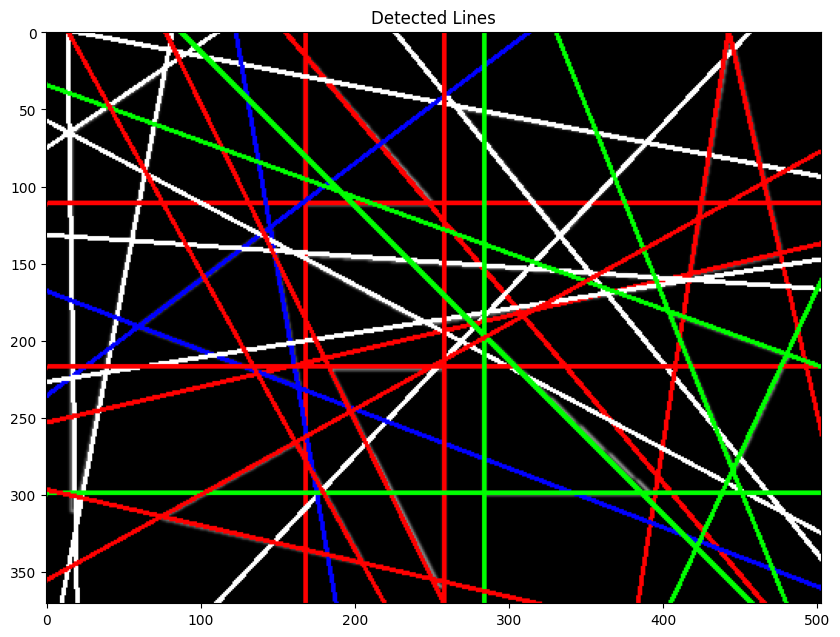

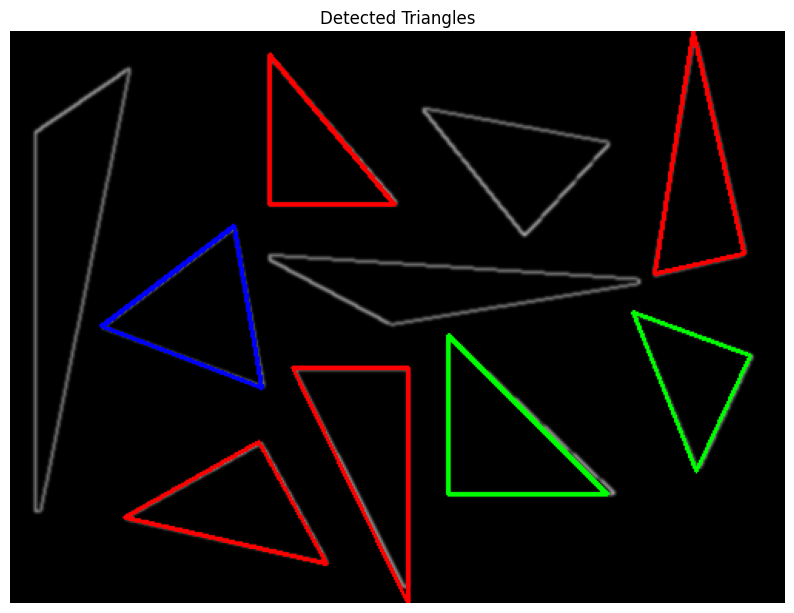

In [ ]:
sketch_image = cv2.imread('what_is_a_triangle.png')
gray_sketch_image= cv2.cvtColor(sketch_image, cv2.COLOR_BGR2GRAY)
edge_sketch_image = create_edge_map(sketch_image.copy())

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(sketch_image, cv2.COLOR_BGR2RGB))
plt.title('sketch_image')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(edge_sketch_image, cv2.COLOR_BGR2RGB))
plt.title('Edge Map')
plt.axis('off')
plt.show()


filtered_edge_sketch_image = cv2.GaussianBlur(edge_sketch_image.copy(), (5,5),1)
# print(len(sketch_image_detected_lines))
step_size_to_right = 20
step_size_to_down = 40
window_height = 100
window_width = 100

sketch_image_detected_lines, all_peaks, accumulators = sliding_window(gray_sketch_image ,window_height , window_width, step_size_to_right, step_size_to_down, threshold=50)
# print(len(sketch_image_detected_lines))
triangles = find_triangles(filtered_edge_sketch_image, sketch_image_detected_lines, 55, 0.95)
filtered_triangles = remove_close_triangles(triangles, 10)
filtered_triangles = filter_invalid(filtered_triangles, sketch_image)


classified_triangles = [(triangle, classify_triangle(triangle, 0.9, 0.004, 0.04, 0.04)) for triangle in filtered_triangles]
drawn_classified_triangles = cv2.cvtColor(filtered_edge_sketch_image.copy(), cv2.COLOR_GRAY2BGR)


filtered_accumulators = filter_accumulator_lines(classified_triangles, accumulators)
plot_filtered_accumulators_and_edges(filtered_accumulators, classified_triangles, sketch_image.copy())

accumulator, rhos, thetas = hough_transform(create_edge_map(sketch_image))
#draw peaks
draw_classified_peaks_on_accumulator(accumulator, classified_triangles, rhos, thetas, all_peaks)
# draw lines
draw_lines_on_image(cv2.cvtColor(filtered_edge_sketch_image.copy(), cv2.COLOR_GRAY2BGR), classified_triangles)


# draw classification
for triangle, classification in classified_triangles:
    color = (255, 0, 0) if classification == "Equilateral" else (0, 255, 0) if classification in ["Isosceles", "Right Isosceles"] else (0, 0, 255) if classification == "Right" else (255, 255, 255)
    triangle = triangle[0]
    if classification != 'Scalene':
      # Draw triangle
      cv2.line(drawn_classified_triangles, triangle[0], triangle[1], color, 2)
      cv2.line(drawn_classified_triangles, triangle[1], triangle[2], color, 2)
      cv2.line(drawn_classified_triangles, triangle[2], triangle[0], color, 2)
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(drawn_classified_triangles, cv2.COLOR_BGR2RGB))
plt.title('Detected Triangles')
plt.axis('off')
plt.show()



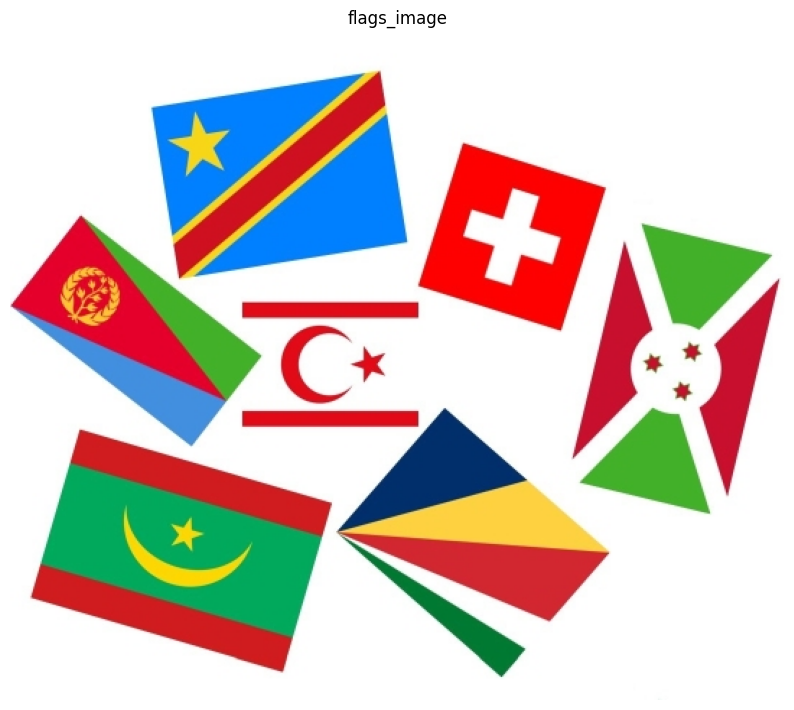

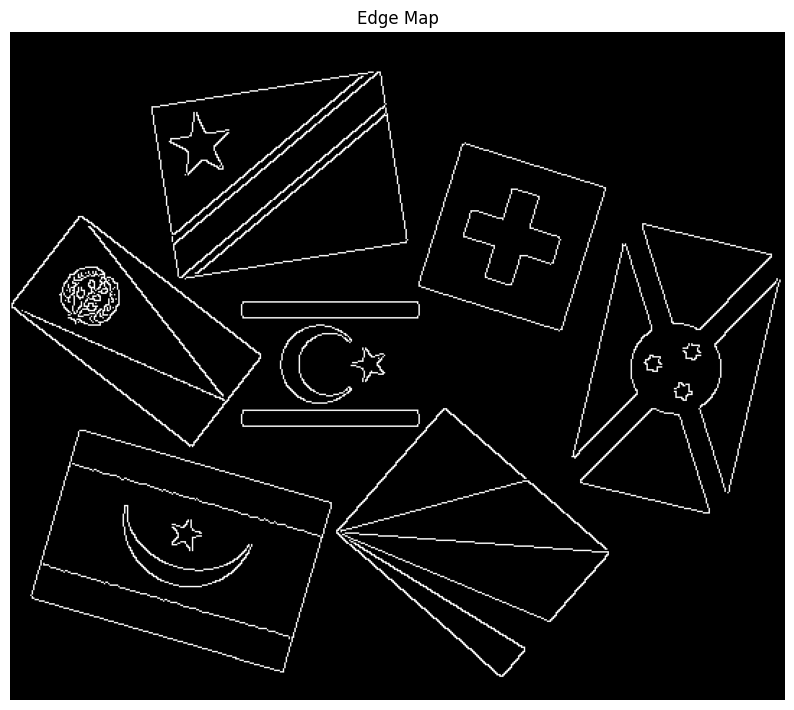

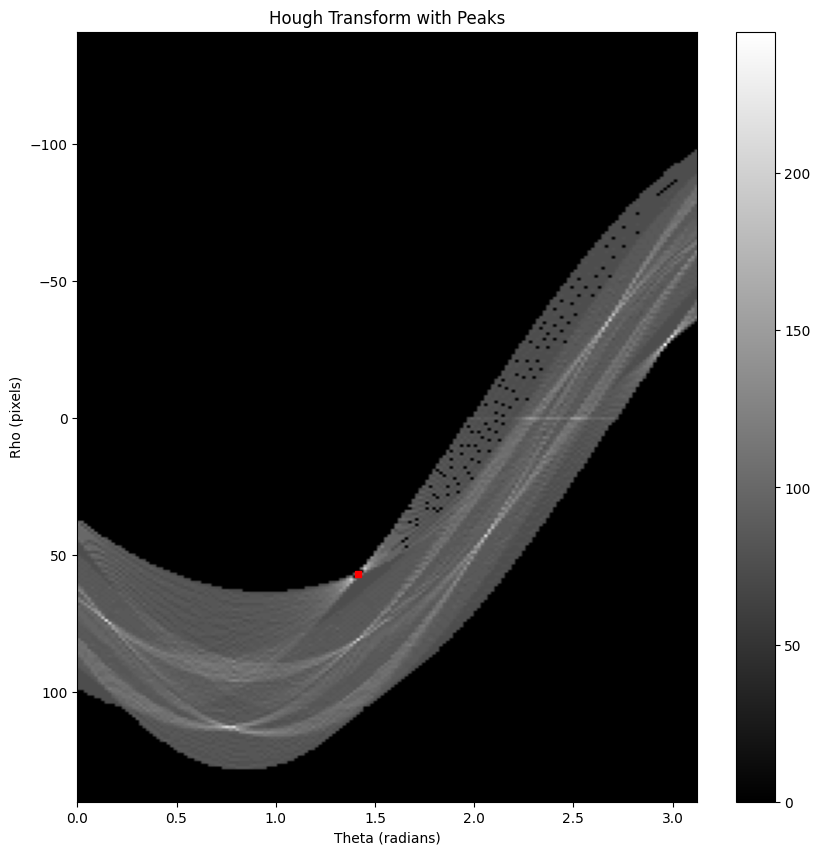

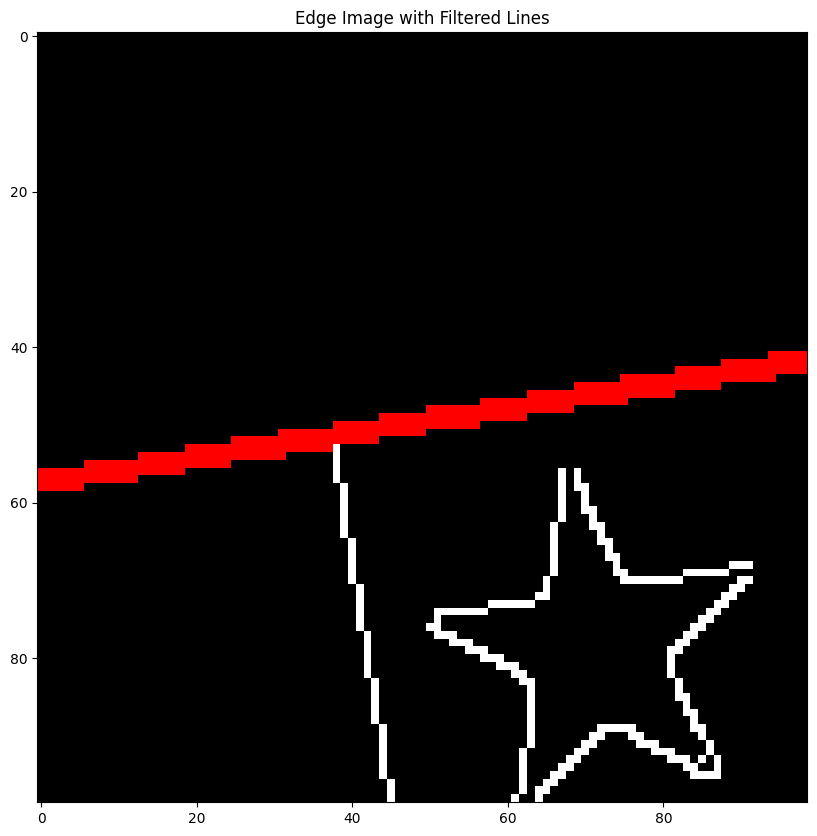

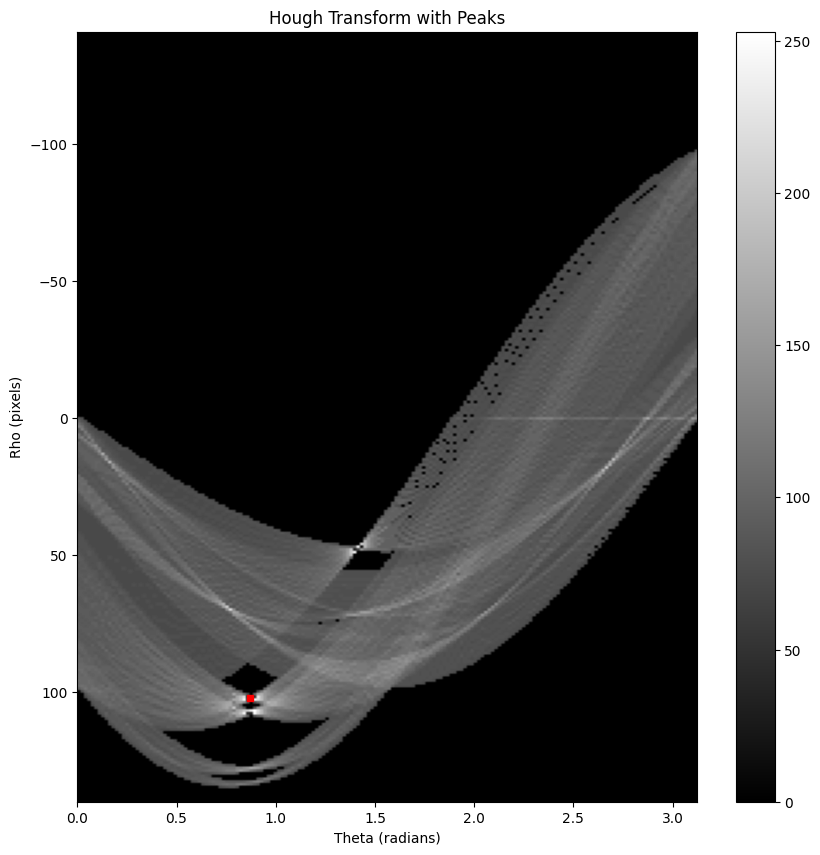

...

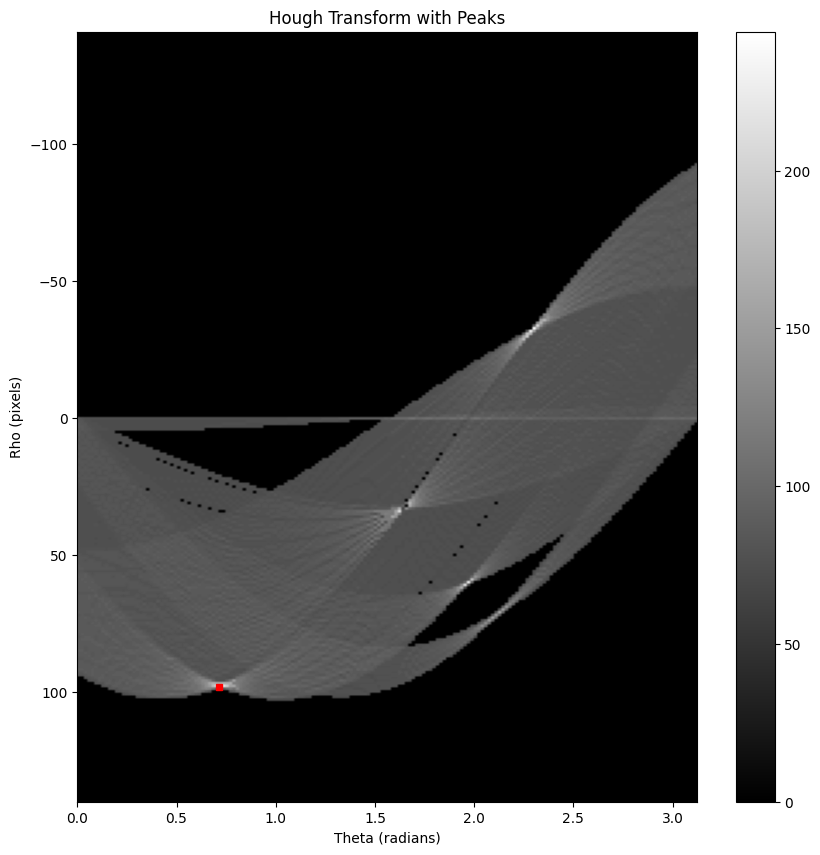

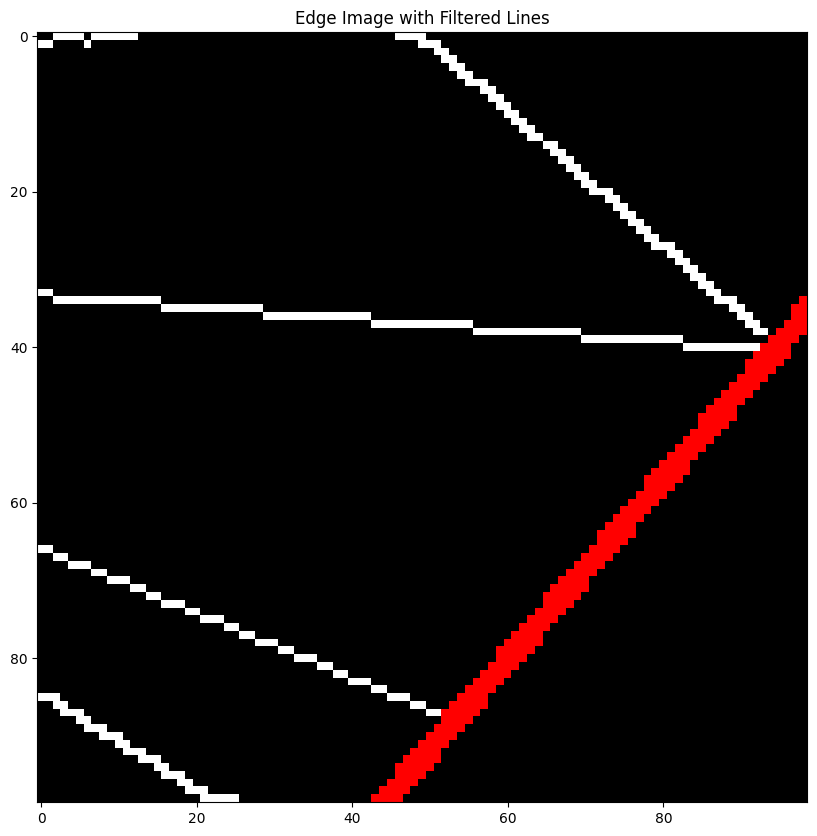

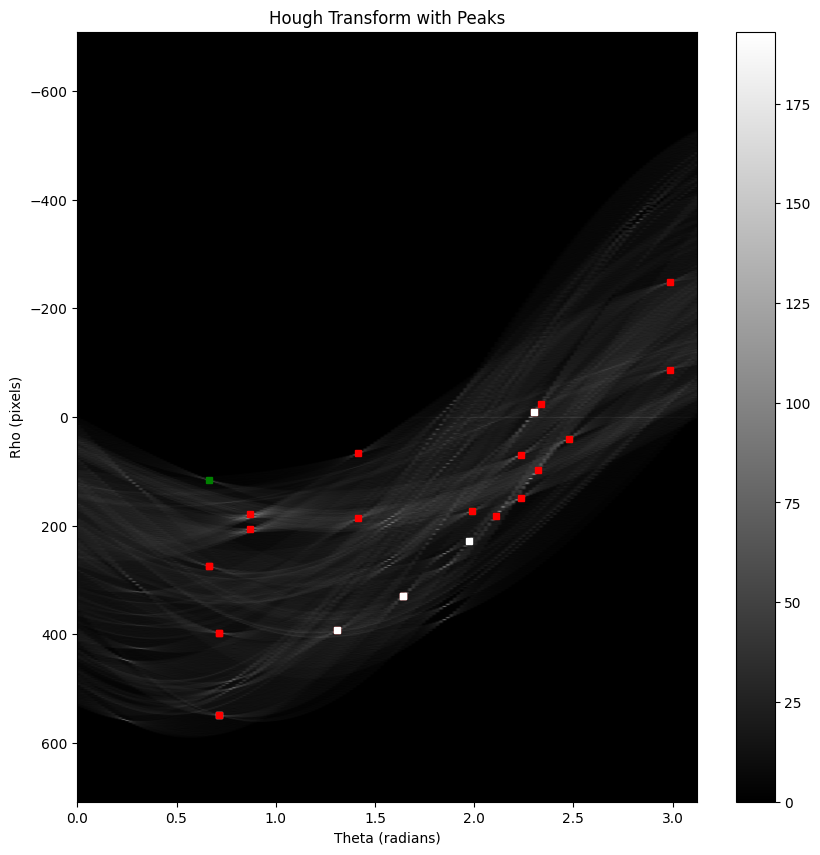

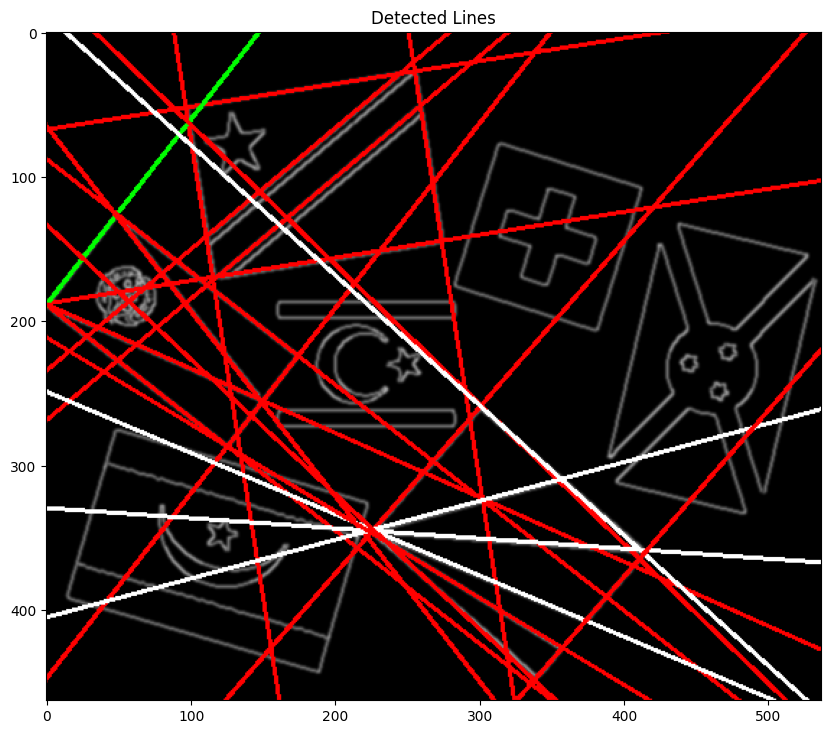

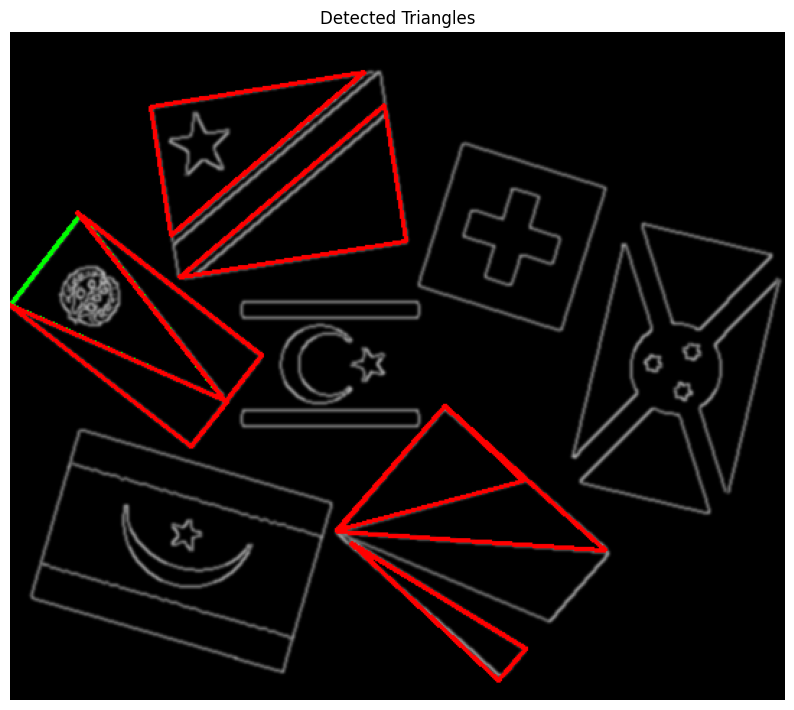

In [ ]:
flags_image = cv2.imread('flags1.jpg')
gray_flags_image= cv2.cvtColor(flags_image, cv2.COLOR_BGR2GRAY)
edge_flags_image = create_edge_map(flags_image.copy())

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(flags_image, cv2.COLOR_BGR2RGB))
plt.title('flags_image')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(edge_flags_image, cv2.COLOR_BGR2RGB))
plt.title('Edge Map')
plt.axis('off')
plt.show()


filtered_edge_flags_image = cv2.GaussianBlur(edge_flags_image.copy(), (5,5),1)

step_size_to_right = 20
step_size_to_down = 40
window_height = 100
window_width = 100

flags_image_detected_lines, all_peaks, accumulators = sliding_window(gray_flags_image ,window_height , window_width, step_size_to_right, step_size_to_down, threshold=50)

triangles = find_triangles(filtered_edge_flags_image, flags_image_detected_lines, 25, 0.98)
filtered_triangles = remove_close_triangles(triangles, 7)
filtered_triangles = filter_invalid(filtered_triangles, flags_image)


classified_triangles = [(triangle, classify_triangle(triangle, 0.9, 0.06, 0.004, 0.1)) for triangle in filtered_triangles]
drawn_classified_triangles = cv2.cvtColor(filtered_edge_flags_image.copy(), cv2.COLOR_GRAY2BGR)

accumulator, rhos, thetas = hough_transform(create_edge_map(flags_image))

filtered_accumulators = filter_accumulator_lines(classified_triangles, accumulators)
plot_filtered_accumulators_and_edges(filtered_accumulators, classified_triangles, flags_image.copy())

#draw peaks
draw_classified_peaks_on_accumulator(accumulator, classified_triangles, rhos, thetas, all_peaks)
# draw lines
draw_lines_on_image(cv2.cvtColor(filtered_edge_flags_image.copy(), cv2.COLOR_GRAY2BGR), classified_triangles)


# draw classification
for triangle, classification in classified_triangles:
    color = (255, 0, 0) if classification == "Equilateral" else (0, 255, 0) if classification in ["Isosceles", "Right Isosceles"] else (0, 0, 255) if classification == "Right" else (255, 255, 255)
    triangle = triangle[0]
    if classification != 'Scalene':
      # Draw triangle
      cv2.line(drawn_classified_triangles, triangle[0], triangle[1], color, 2)
      cv2.line(drawn_classified_triangles, triangle[1], triangle[2], color, 2)
      cv2.line(drawn_classified_triangles, triangle[2], triangle[0], color, 2)
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(drawn_classified_triangles, cv2.COLOR_BGR2RGB))
plt.title('Detected Triangles')
plt.axis('off')
plt.show()


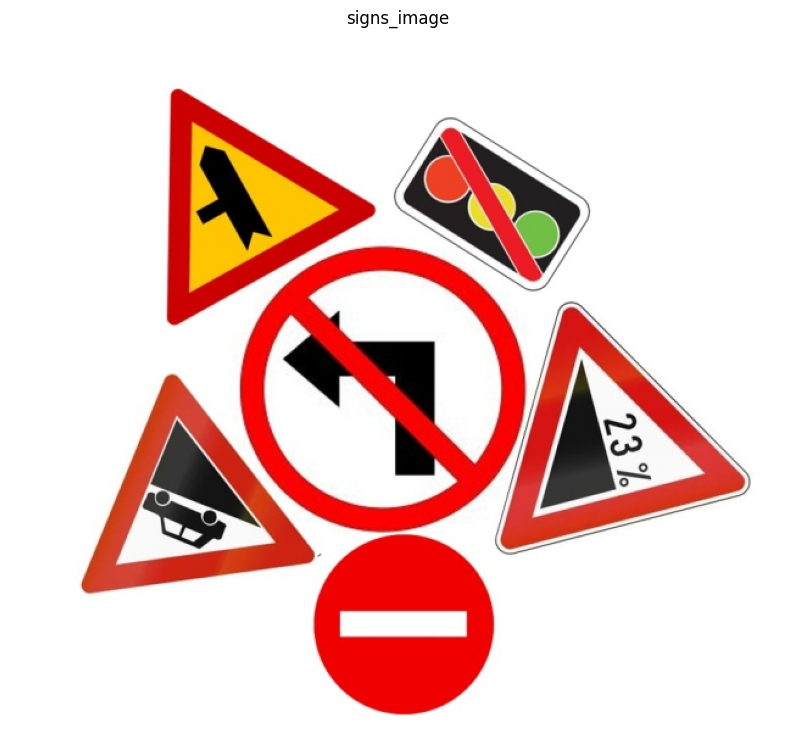

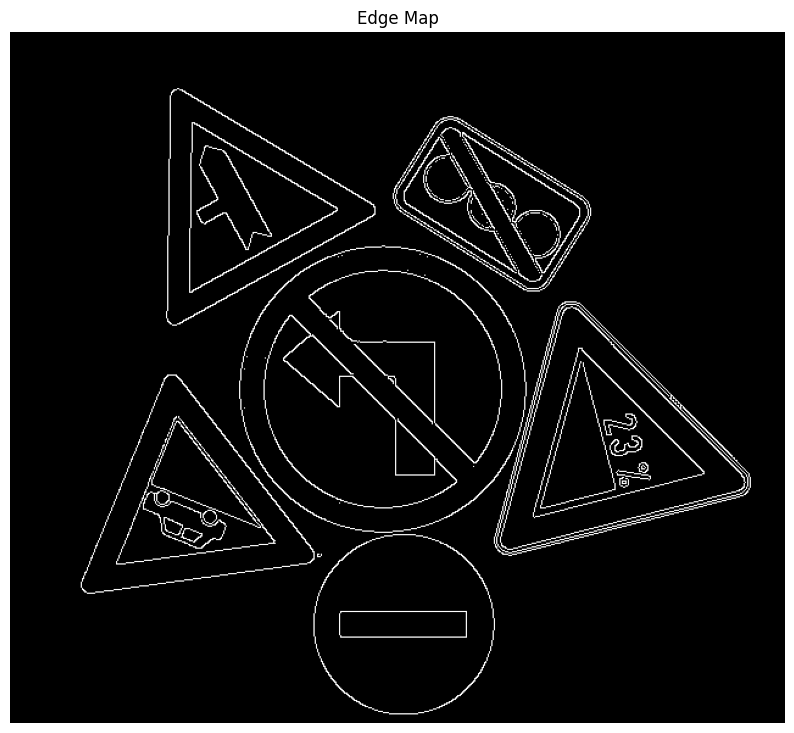

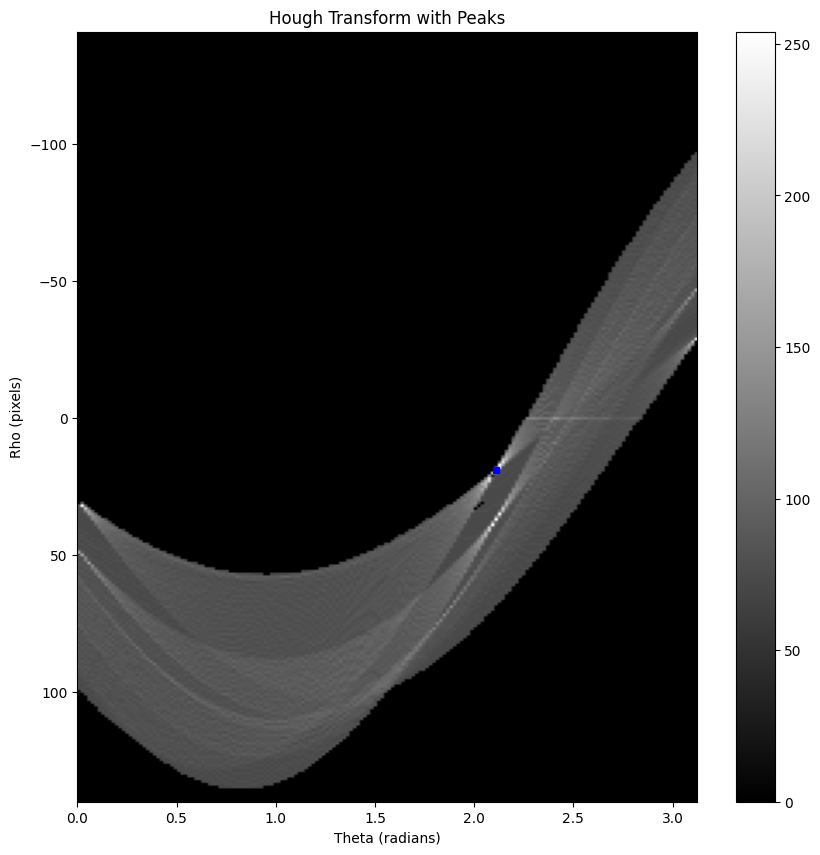

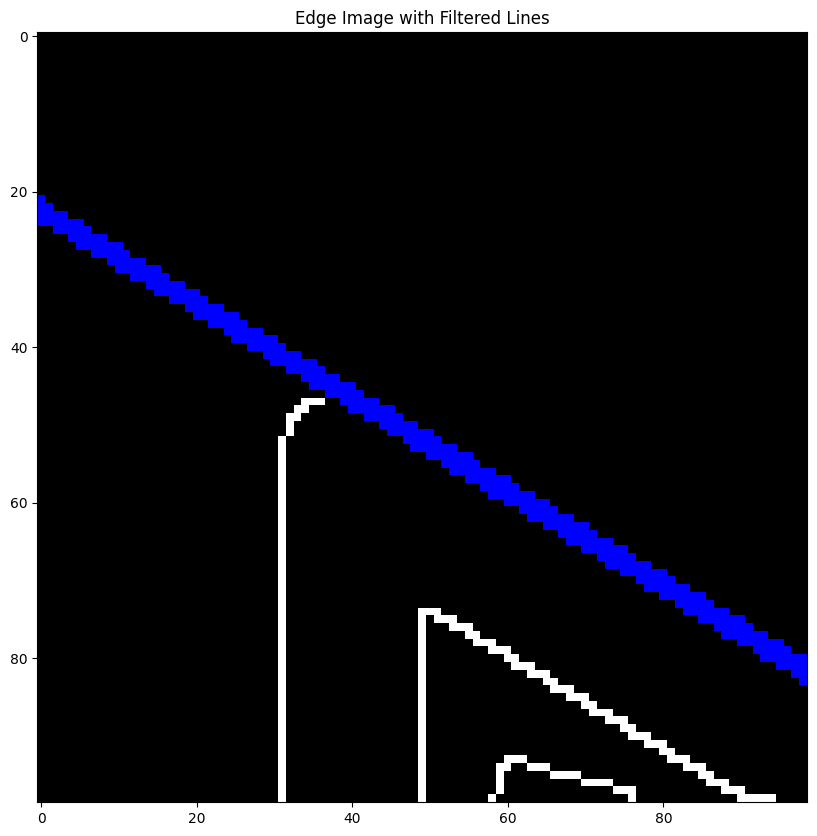

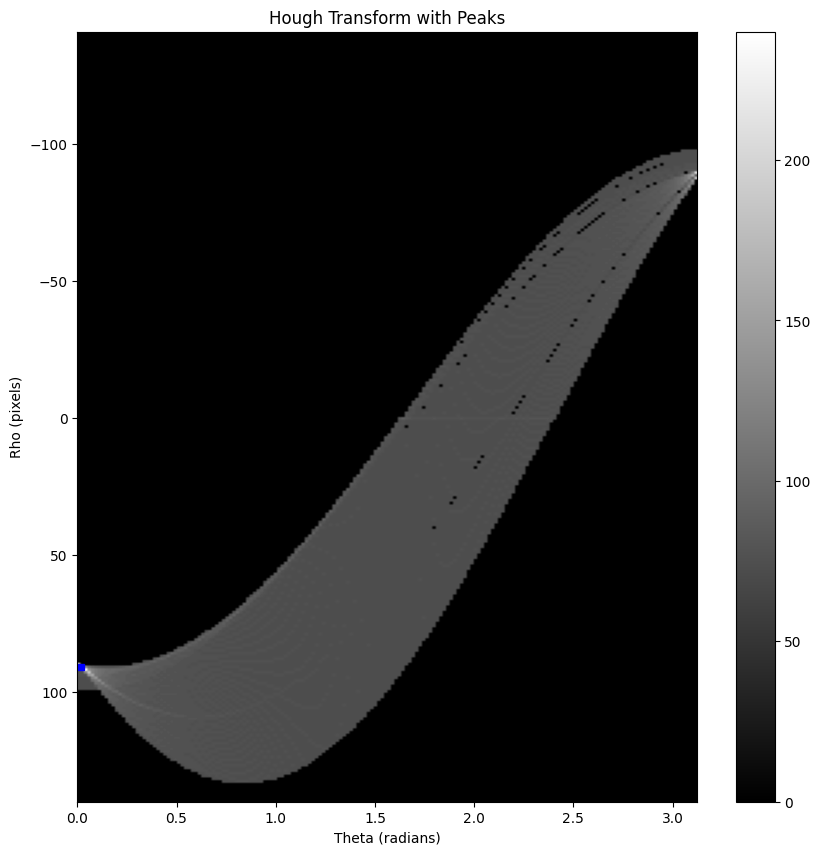

...

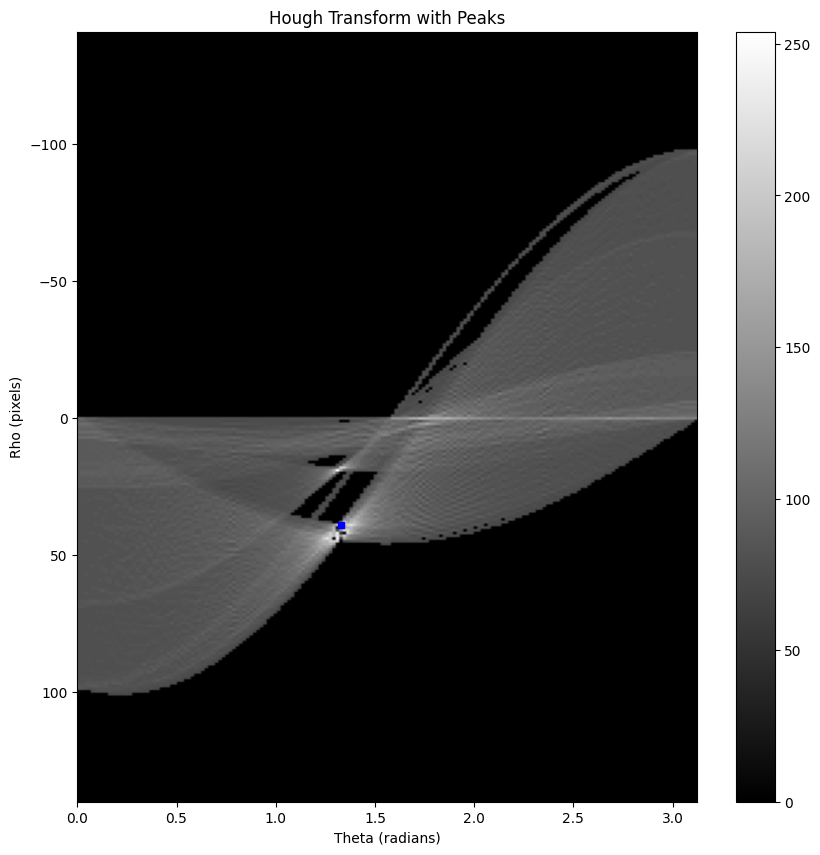

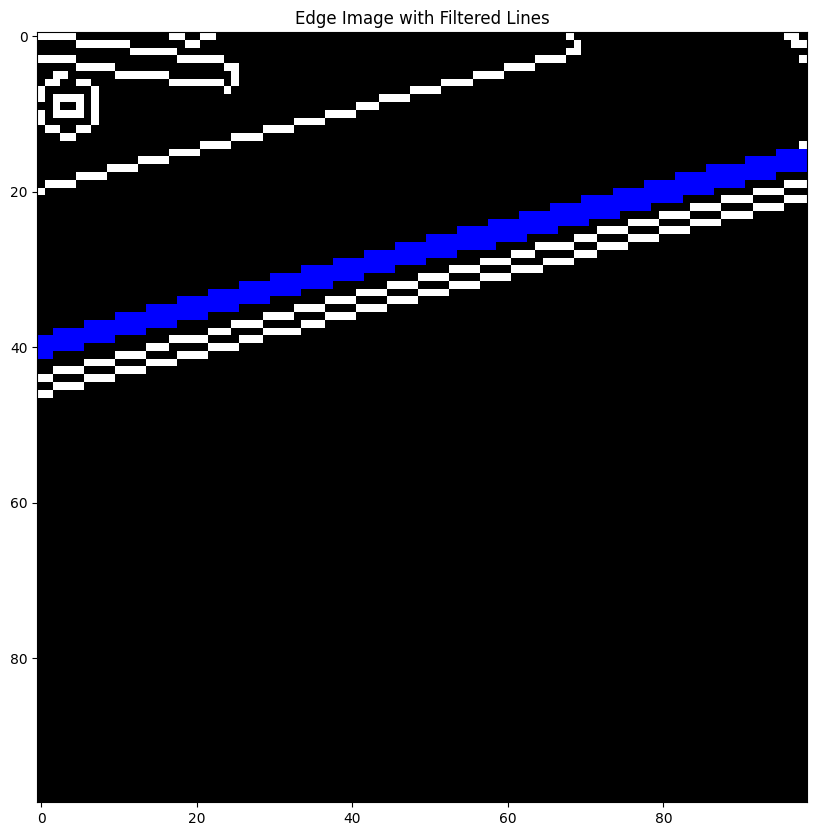

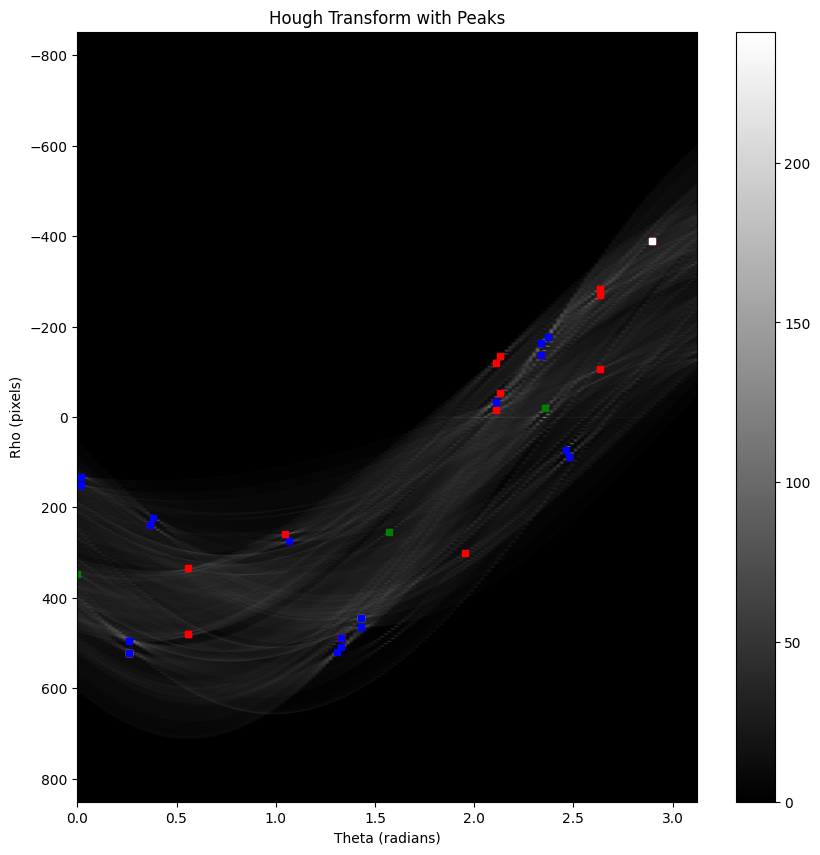

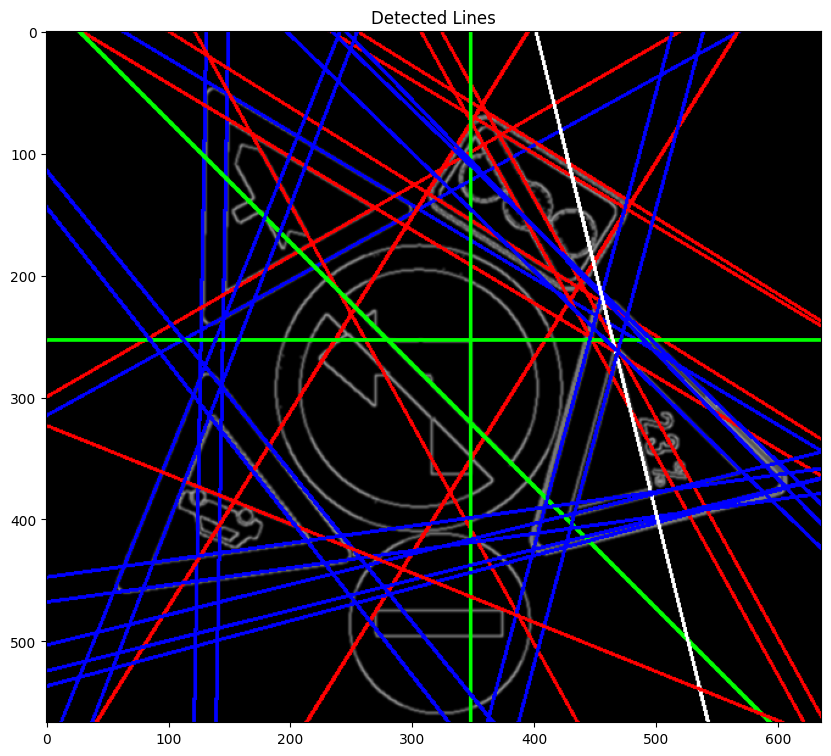

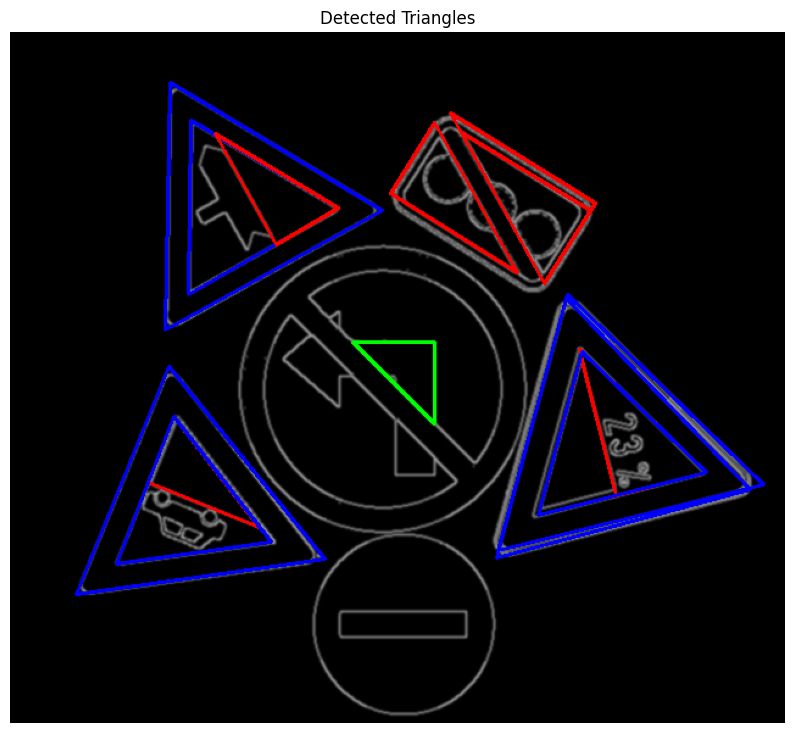

In [ ]:
signs_image = cv2.imread('t_signs2.jpg')
gray_signs_image= cv2.cvtColor(signs_image, cv2.COLOR_BGR2GRAY)
edge_signs_image = create_edge_map(signs_image.copy())

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(signs_image, cv2.COLOR_BGR2RGB))
plt.title('signs_image')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(edge_signs_image, cv2.COLOR_BGR2RGB))
plt.title('Edge Map')
plt.axis('off')
plt.show()


filtered_edge_signs_image = cv2.GaussianBlur(edge_signs_image.copy(), (5,5),1)

step_size_to_right = 20
step_size_to_down = 40
window_height = 100
window_width = 100

signs_image_detected_lines, all_peaks, accumulators = sliding_window(gray_signs_image ,window_height , window_width, step_size_to_right, step_size_to_down, threshold=50)
triangles = find_triangles(filtered_edge_signs_image, signs_image_detected_lines, 57, 0.95)
filtered_triangles = remove_close_triangles(triangles, 7)
filtered_triangles = filter_invalid(filtered_triangles, signs_image)


classified_triangles = [(triangle, classify_triangle(triangle, 0.9, 0.05, 0.004)) for triangle in filtered_triangles]
drawn_classified_triangles = cv2.cvtColor(filtered_edge_signs_image.copy(), cv2.COLOR_GRAY2BGR)

filtered_accumulators = filter_accumulator_lines(classified_triangles, accumulators)
plot_filtered_accumulators_and_edges(filtered_accumulators, classified_triangles, signs_image.copy())

accumulator, rhos, thetas = hough_transform(create_edge_map(signs_image))
#draw peaks
draw_classified_peaks_on_accumulator(accumulator, classified_triangles, rhos, thetas, all_peaks)
# draw lines
draw_lines_on_image(cv2.cvtColor(filtered_edge_signs_image.copy(), cv2.COLOR_GRAY2BGR), classified_triangles)


# draw classification
for triangle, classification in classified_triangles:
    color = (255, 0, 0) if classification == "Equilateral" else (0, 255, 0) if classification in ["Isosceles", "Right Isosceles"] else (0, 0, 255) if classification == "Right" else (255, 255, 255)
    triangle = triangle[0]
    if classification != 'Scalene':
      # Draw triangle
      cv2.line(drawn_classified_triangles, triangle[0], triangle[1], color, 2)
      cv2.line(drawn_classified_triangles, triangle[1], triangle[2], color, 2)
      cv2.line(drawn_classified_triangles, triangle[2], triangle[0], color, 2)
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(drawn_classified_triangles, cv2.COLOR_BGR2RGB))
plt.title('Detected Triangles')
plt.axis('off')
plt.show()


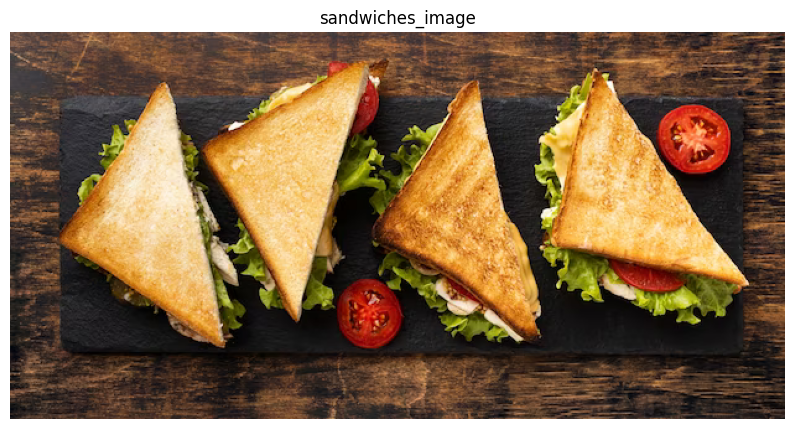

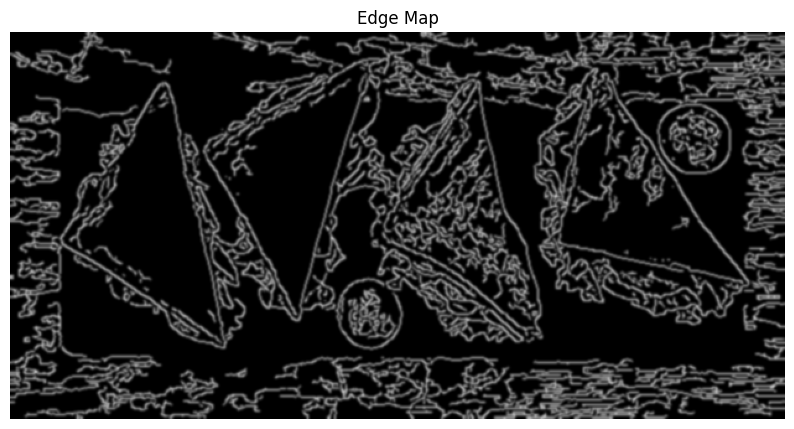

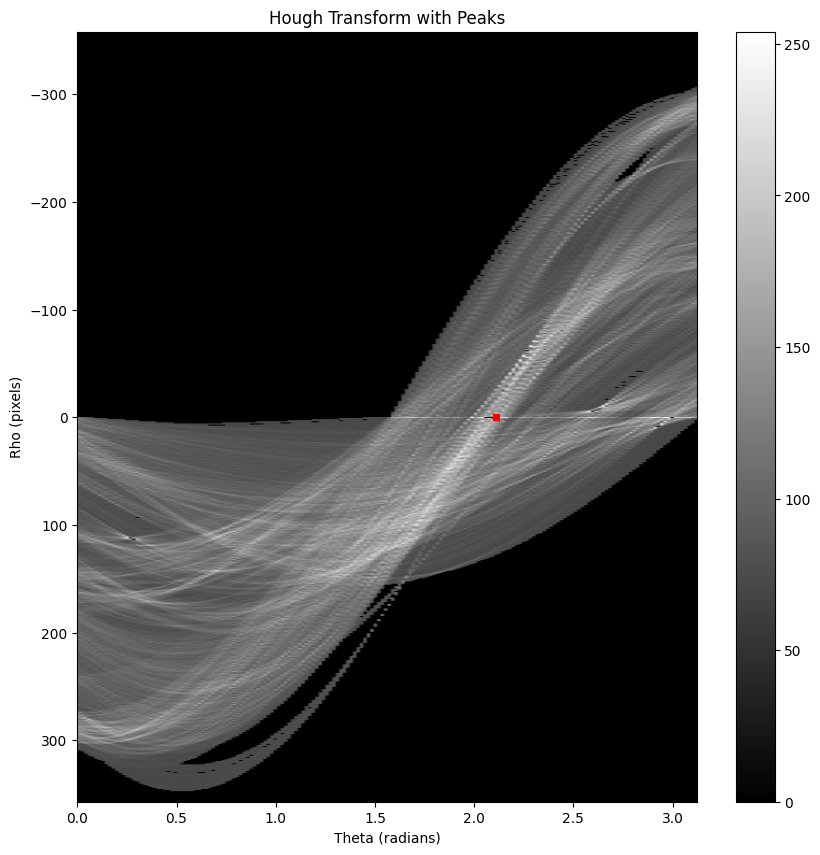

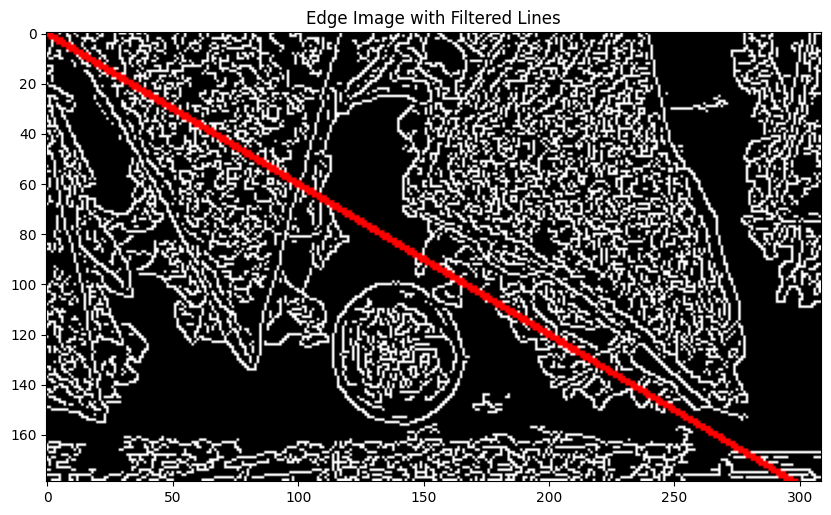

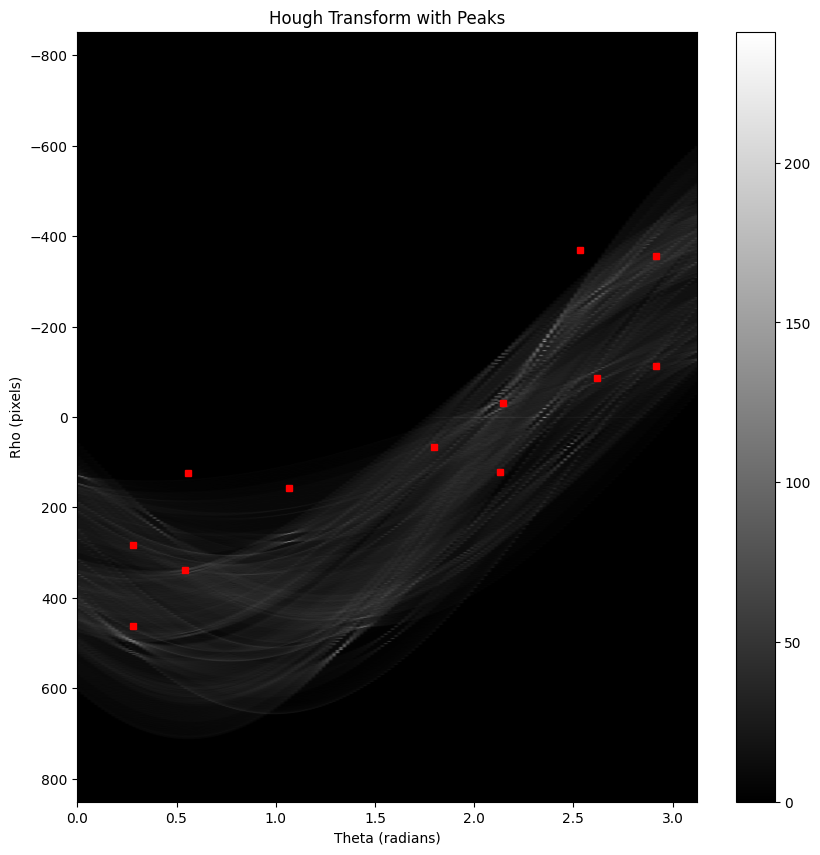

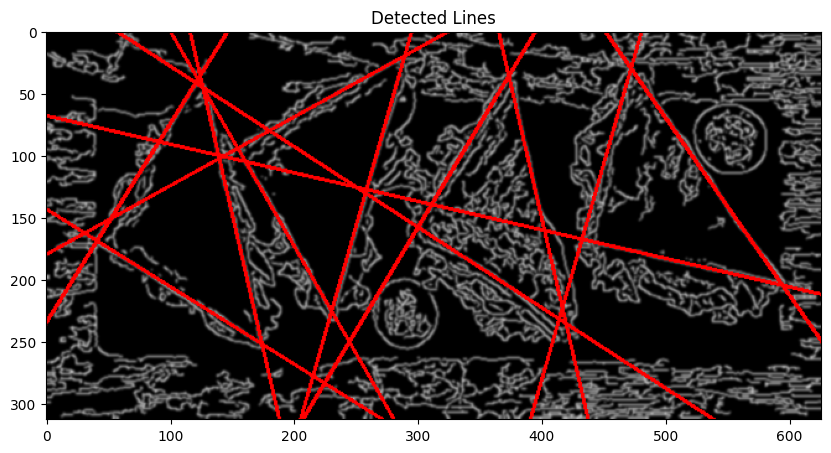

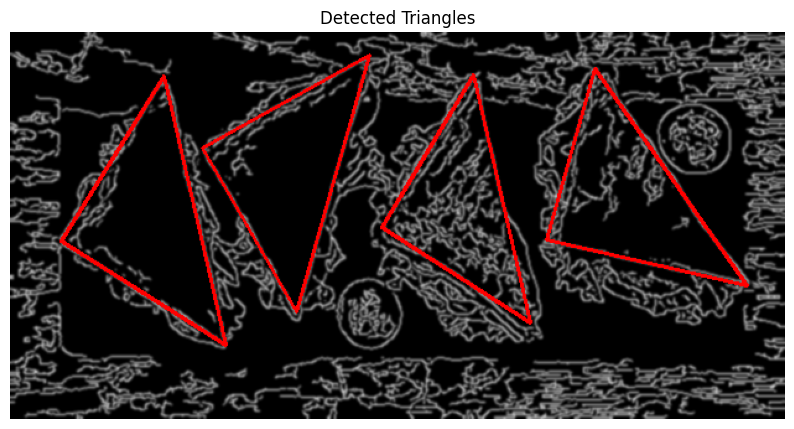

In [ ]:
sandwiches_image = cv2.imread('top-view-triangle-sandwiches-slate-with-tomatoes_23-2148640143.png')
gray_sandwiches_image= cv2.cvtColor(sandwiches_image, cv2.COLOR_BGR2GRAY)
filtered_gray_sandwiches_image = cv2.bilateralFilter(gray_sandwiches_image, d=13, sigmaColor=25, sigmaSpace=200)
filtered_gray_sandwiches_image = cv2.GaussianBlur(filtered_gray_sandwiches_image, (13,13),1)

edge_sandwiches_image = create_edge_map(filtered_gray_sandwiches_image.copy(), 10, 50)
filtered_edge_sandwiches_image = cv2.GaussianBlur(edge_sandwiches_image.copy(), (5,5),1)

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(sandwiches_image, cv2.COLOR_BGR2RGB))
plt.title('sandwiches_image')
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(filtered_edge_sandwiches_image, cv2.COLOR_BGR2RGB))
plt.title('Edge Map')
plt.axis('off')
plt.show()




step_size_to_right = 150
step_size_to_down = 20
window_height = 180
window_width = 310

sandwiches_image_detected_lines, all_peaks, accumulators = sliding_window(filtered_gray_sandwiches_image ,window_height , window_width, step_size_to_right, step_size_to_down, threshold=50)

triangles = find_triangles(filtered_edge_sandwiches_image, sandwiches_image_detected_lines, 139, 0.90)
filtered_triangles = remove_close_triangles(triangles, 20)
filtered_triangles = filter_invalid(filtered_triangles, sandwiches_image, 15)

filtered_accumulators = filter_accumulator_lines(classified_triangles, accumulators)
plot_filtered_accumulators_and_edges(filtered_accumulators, classified_triangles, sandwiches_image.copy())

classified_triangles = [(triangle, classify_triangle(triangle, 0.9, 0.001, 0.0004, 0.08)) for triangle in filtered_triangles]
drawn_classified_triangles = cv2.cvtColor(filtered_edge_sandwiches_image.copy(), cv2.COLOR_GRAY2BGR)

# accumulator, rhos, thetas = hough_transform(create_edge_map(sandwiches_image))
#draw peaks
draw_classified_peaks_on_accumulator(accumulator, classified_triangles, rhos, thetas, all_peaks)
# draw lines
draw_lines_on_image(cv2.cvtColor(filtered_edge_sandwiches_image.copy(), cv2.COLOR_GRAY2BGR), classified_triangles)


# draw classification
for triangle, classification in classified_triangles:
    color = (0, 0, 255) if classification == "Equilateral" else (0, 255, 0) if classification in ["Isosceles", "Right Isosceles"] else (0, 0, 255) if classification == "Right" else (255, 255, 255)
    triangle = triangle[0]
    if classification != 'Scalene':
      # Draw triangle
      cv2.line(drawn_classified_triangles, triangle[0], triangle[1], color, 2)
      cv2.line(drawn_classified_triangles, triangle[1], triangle[2], color, 2)
      cv2.line(drawn_classified_triangles, triangle[2], triangle[0], color, 2)
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(drawn_classified_triangles, cv2.COLOR_BGR2RGB))
plt.title('Detected Triangles')
plt.axis('off')
plt.show()


### **Explanation of your solution** (fill in here)
---

1) Explain in short detail the stages of your solution

Our solution was based on finding the correct lines that form the triangles in the image, we did that by finding the hough transform and detect peaks that represent rho and theta which defines a line.
To be able to detect all the lines and to detect a minimal amout of false postive lines we did ***sliding window only to detect "good lines"***. means we did not use it to detect triangles, but only the lines, so it is not really sliding window but some version of it.
We used this approach because it was efficient
, fast and gave overall great results.


---


Here is our approach:

  1.   For each image we chose a window size of (100,100), and step size to right and down are 20,40 respectively. (except for sandwiches image we chose a window of size (310,180) and only made steps to the right.
  2.   For each window we found the Hough transform by using the edge map of the current window. We filtered out weak peaks by using maximum filtering of a neighbourhood of size (100,100). This helped us not choosing redundant lines. Then we did non maximum supperssion to remove redundant lines that maximum filtering couldn't remove. By that we got all the lines which are candidates to be a part of sides of triangles.

  1. To identify triangles we checked every combination of 3 lines that forms a triangle. for every combination we did the following:

    1.   we got the intersection of the 3 lines, which forms 3 points.

    1.   each two point forms a line that is a candidate to be a triangle side. For the 3 lines we get we checked if their length is greater than some threshold, if yes this means that these 3 lines can be as sides in a triangle. else we move to the other combination.
    2. given that the 3 lines are greater than the threshold, means that they form a triangle, let's call it triangle X. We define a mask of size of edge image. and we fill the pixels that represent triangle X in mask by a nonzero value. Till now we got mask which represent triangle X, now we do **bitwise AND** between the mask and the edge image, if triangle X is really a triangle in the input image, the resut of the **bitwise and** should be that the majority of the nonzero pixels in the mask before the bitwise operation are still non zero pixels after the operation. for that we chose a threshold, if the result is greter than threshold, means that is X is a triangle in the input image.
    4. But before using the edge image in step 3 we blurred it by using Gaussian Blur, to get more accurate results.

    5. After we got all the triangles now we must classify them to equilateral, isosceles, right isosceles or right triangles. To identify:
      1. **equilateral triangles**: we computed the sides of the triangles by calculating the Eculidean distance between  vertices of the triangle. if all of them are equal then it is equilateral.
      
      2. **isosceles/ right isosceles triangles**: calculate the Eculidean distance between vertices of the triangle, if at least two sides are equal then it is isosceles. to check if they are right isosceles, we ordered the sides based on length, and applied pythagoras.

      3. **right isosceles**: we ordered the sides based on length, and applied pythagoras.
    
    6. To plot the results:

      1. We ploted the detected peaks on hough transform, and the detected lines on the edge map for each window that we found in it a line that belong to a triangle. we did that because as we mentioned earlier we only do sliding window to detect lines not triangles.
      2. We used the lines of the triangle to Hough transfrom and plot the peaks of classified triangles each with it's color-coded color.
      3. the same with lines. for triangles which are non of the types above we drawn it using white color.(as an indication that we also detected them.)
      4. Also, the same with detected trinagles.




Over all our code is generic for every input image. But before, we need to pick the correct parameters for each image. But over all it works almost for every image.






---




2) Explain some problems/difficulties that you encountered and what you did to overcome them.






1. We had a difficulty at first for detecting lines of triangles, at first we did not try sliding window, it gave us enormous number of lines. So we tried the sliding window approach to identify lines only. it helpes us alot.

2. To remove redundant lines we tried different values of thresholds for peaks point in hough transform. But that didn't work very well, we tried the sliding window apporach and at each window we did maximum filtering and non maximum suppression which worked really good according to results.

3. Some input images have a lot of noise, it caused at first problem but at last we did filter them and reduced the noise, for example we used bilateral filtering and Gaussian Blur for the sandwiches image. The same for edge images, we blurred them using Gaussian Blur.

4. We had a problem that the intersection of many lines can create false triangles which are not in input image, we over comed that by doing BITWISE AND with edge image, that helped reduce redundant triangles. In addition, however how much the threshold was good to detect triangles sometimes it did detected false postive triangles which are not even in the image or false triangles which were detected due to noise, we removed these trinangles successfully by filtering them out.

5. There was cases when we detected the same triangle more than once, this happen because there are lines close alot to each other which we could not remove, so to overcome this problem we searched if there are trinagles which are close to each other based on the placing of the vertices and removed them.

6. When we classified triangles we used np.close to check if the lines are really close but there was a problem with the lines that we detected, they weren't always perfect, so this will affect the length and the type of the identifed triangle. so we chose some thresholds for each type of triangle.



---


3) Specify and explain in short some limitations of your approach (You may refer to the results in any of the output images).
1. one limitation that we faced is our approach might detect false positive triangles that are not real triangles in the input image, and when trying to remove them it removes other triangles, for example in the sign image from group signs, we can see that there is a false postive triangle that has been detected. we tried to remove it but it affected other triangles.
2. for complex images our approach might not detect all the triangles, this based on the fact the images are complex, and there might be a necessity to handle them correctly by filtering and noise reduction. Or it might not even work for other images.

